Group : Divya, Nupur, Ranadheer, Varun

**Importing libraries needed**

In [461]:
import pandas as pd
import os, csv
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.stattools import adfuller 
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectFromModel

**Loading dataset**

In [462]:
USRess = pd.read_csv("/content/sample_data/US_Recessions.csv")

**Data Overview**

In [463]:
USRess.head()

,date,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC
0,1/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.62
1,2/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.67
2,3/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.30
3,4/1/1959,n,0.000000,0.37,0.014302,0.006168,0.000541,-0.164,1.14
4,5/1/1959,n,-0.000345,0.16,0.021079,0.005774,0.038048,-0.230,1.20


In [464]:
USRess

,date,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC
0,1/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.62
1,2/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.67
2,3/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.30
3,4/1/1959,n,0.000000,0.37,0.014302,0.006168,0.000541,-0.164,1.14
4,5/1/1959,n,-0.000345,0.16,0.021079,0.005774,0.038048,-0.230,1.20
...,...,...,...,...,...,...,...,...,...
703,8/1/2017,n,-0.000840,0.11,-0.000404,0.001555,0.019164,-0.036,0.96
704,9/1/2017,n,0.000610,0.01,-0.004748,0.001294,0.000546,0.254,1.18
705,10/1/2017,n,0.000254,-0.01,0.000026,0.000286,0.019119,-0.239,1.23
706,11/1/2017,n,0.003779,0.00,0.015057,0.001693,0.021946,-0.220,1.26


In [465]:
USRess.dtypes

date          object
RECESSION     object
CPI          float64
FEDFUNDS     float64
INDPRO       float64
PAYEMS       float64
SP500        float64
UNEMPLOY     float64
YC           float64
dtype: object

In [466]:
USRess.shape

(708, 9)

In [467]:
USRess.columns

Index(['date', 'RECESSION', 'CPI', 'FEDFUNDS', 'INDPRO', 'PAYEMS', 'SP500',
       'UNEMPLOY', 'YC'],
      dtype='object')

In [468]:
USRess = USRess.rename(columns={'date':'DATE'})

In [469]:
USRess

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC
0,1/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.62
1,2/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.67
2,3/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.30
3,4/1/1959,n,0.000000,0.37,0.014302,0.006168,0.000541,-0.164,1.14
4,5/1/1959,n,-0.000345,0.16,0.021079,0.005774,0.038048,-0.230,1.20
...,...,...,...,...,...,...,...,...,...
703,8/1/2017,n,-0.000840,0.11,-0.000404,0.001555,0.019164,-0.036,0.96
704,9/1/2017,n,0.000610,0.01,-0.004748,0.001294,0.000546,0.254,1.18
705,10/1/2017,n,0.000254,-0.01,0.000026,0.000286,0.019119,-0.239,1.23
706,11/1/2017,n,0.003779,0.00,0.015057,0.001693,0.021946,-0.220,1.26


In [470]:
USRess['YEAR'] = USRess['DATE'].str[-4:]

In [471]:
USRess

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC,YEAR
0,1/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.62,1959
1,2/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.67,1959
2,3/1/1959,n,0.000000,-0.05,0.019395,0.003994,-0.000722,-0.103,1.30,1959
3,4/1/1959,n,0.000000,0.37,0.014302,0.006168,0.000541,-0.164,1.14,1959
4,5/1/1959,n,-0.000345,0.16,0.021079,0.005774,0.038048,-0.230,1.20,1959
...,...,...,...,...,...,...,...,...,...,...
703,8/1/2017,n,-0.000840,0.11,-0.000404,0.001555,0.019164,-0.036,0.96,2017
704,9/1/2017,n,0.000610,0.01,-0.004748,0.001294,0.000546,0.254,1.18,2017
705,10/1/2017,n,0.000254,-0.01,0.000026,0.000286,0.019119,-0.239,1.23,2017
706,11/1/2017,n,0.003779,0.00,0.015057,0.001693,0.021946,-0.220,1.26,2017


In [472]:
USData = USRess.groupby('YEAR')['UNEMPLOY'].mean()

In [473]:
USData

YEAR
1959   -0.022583
1960    0.027250
1961   -0.002917
1962   -0.022583
1963    0.010583
1964   -0.050000
1965   -0.039833
1966   -0.025250
1967    0.024667
1968   -0.029250
1969    0.011750
1970    0.170167
1971    0.021917
1972   -0.046583
1973   -0.017167
1974    0.145333
1975    0.137833
1976   -0.014500
1977   -0.067083
1978   -0.061500
1979    0.013417
1980    0.148750
1981    0.083833
1982    0.242417
1983   -0.203250
1984   -0.108417
1985   -0.005833
1986    0.002583
1987   -0.093667
1988   -0.041500
1989    0.015667
1990    0.086583
1991    0.097250
1992    0.052833
1993   -0.085250
1994   -0.097250
1995    0.004250
1996   -0.015833
1997   -0.077333
1998   -0.017333
1999   -0.032000
2000   -0.006417
2001    0.197000
2002    0.043083
2003    0.004667
2004   -0.053667
2005   -0.030500
2006   -0.057833
2007    0.030667
2008    0.274833
2009    0.390083
2010   -0.011500
2011   -0.148250
2012   -0.108083
2013   -0.101500
2014   -0.141417
2015   -0.090833
2016   -0.037250
2017   -0

In [474]:
USRess.CPI = USRess.CPI*10000
USRess.SP500 = USRess.SP500*100000

In [475]:
print(USRess['YEAR'].unique())

['1959' '1960' '1961' '1962' '1963' '1964' '1965' '1966' '1967' '1968'
 '1969' '1970' '1971' '1972' '1973' '1974' '1975' '1976' '1977' '1978'
 '1979' '1980' '1981' '1982' '1983' '1984' '1985' '1986' '1987' '1988'
 '1989' '1990' '1991' '1992' '1993' '1994' '1995' '1996' '1997' '1998'
 '1999' '2000' '2001' '2002' '2003' '2004' '2005' '2006' '2007' '2008'
 '2009' '2010' '2011' '2012' '2013' '2014' '2015' '2016' '2017']


In [476]:
USRess.RECESSION.value_counts()

n    615
y     93
Name: RECESSION, dtype: int64

In [477]:
US_Recessions = USRess.loc[(USRess['RECESSION'] == 'y')]

In [478]:
US_Recessions

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC,YEAR
16,5/1/1960,y,13.61007,0.08,-0.007961,0.006571,-1768.3462,-0.106,0.25,1960
17,6/1/1960,y,0.00000,-0.07,-0.001143,-0.006186,2649.8882,-0.051,0.78,1960
18,7/1/1960,y,44.10525,-0.53,-0.012650,-0.002334,1933.5343,0.197,0.87,1960
19,8/1/1960,y,10.15057,-0.09,-0.003479,-0.000773,-2508.3589,0.070,1.12,1960
20,9/1/1960,y,13.51808,-0.25,-0.001162,-0.000626,2578.6101,0.110,1.50,1960
...,...,...,...,...,...,...,...,...,...,...
601,2/1/2009,y,-178.64094,-0.01,-0.024037,-0.005831,-8954.9879,0.772,2.80,2009
602,3/1/2009,y,-82.67605,0.07,-0.006470,-0.005558,-11645.6513,0.840,2.53,2009
603,4/1/2009,y,25.27574,-0.04,-0.015983,-0.006019,8195.2693,0.528,3.01,2009
604,5/1/2009,y,36.36042,-0.03,-0.008013,-0.005259,8977.2219,0.427,3.29,2009


In [479]:
US_NO_Recessions = USRess.loc[(USRess['RECESSION'] == 'n')]

In [480]:
US_NO_Recessions

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC,YEAR
0,1/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.62,1959
1,2/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.67,1959
2,3/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.30,1959
3,4/1/1959,n,0.00000,0.37,0.014302,0.006168,54.1254,-0.164,1.14,1959
4,5/1/1959,n,-3.44768,0.16,0.021079,0.005774,3804.7605,-0.230,1.20,1959
...,...,...,...,...,...,...,...,...,...,...
703,8/1/2017,n,-8.39574,0.11,-0.000404,0.001555,1916.4018,-0.036,0.96,2017
704,9/1/2017,n,6.10297,0.01,-0.004748,0.001294,54.6284,0.254,1.18,2017
705,10/1/2017,n,2.53839,-0.01,0.000026,0.000286,1911.9039,-0.239,1.23,2017
706,11/1/2017,n,37.79487,0.00,0.015057,0.001693,2194.5560,-0.220,1.26,2017


In [481]:
US_Recessions.shape #Years where recession occurs

(93, 10)

In [482]:
US_NO_Recessions.shape #Years where recession does not occur

(615, 10)

In [ ]:
US_Recessions['DATE'] = pd.to_datetime(US_Recessions['DATE'])
US_Recessions['YEAR'] = US_Recessions['DATE'].dt.year

In [ ]:
US_NO_Recessions['DATE'] = pd.to_datetime(US_NO_Recessions['DATE'])
US_NO_Recessions['YEAR'] = US_NO_Recessions['DATE'].dt.year

**Analyzing US Recession Data Parameters with and without recession clause**

Text(0.5, 1.0, 'Yearly scatter analysis for Unemployment with Recession')

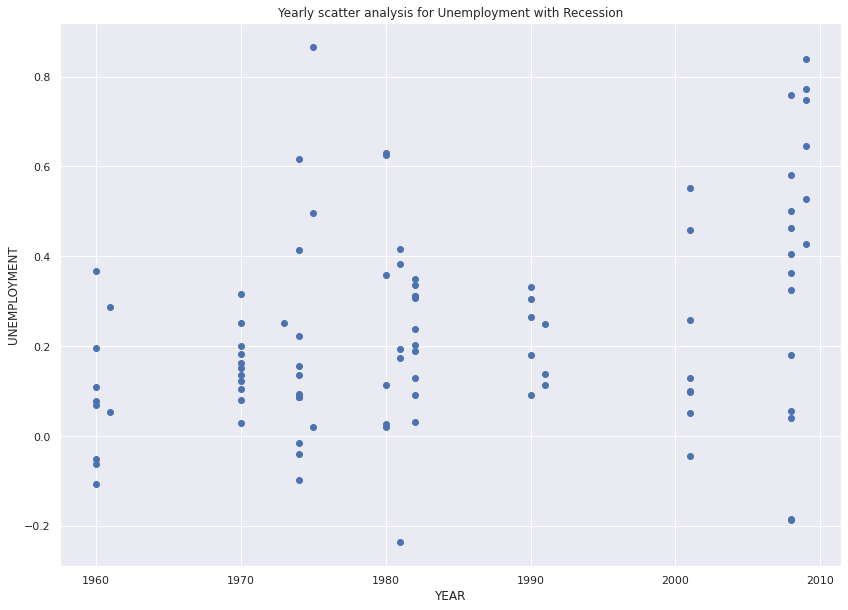

In [485]:
plt.scatter('YEAR','UNEMPLOY',data=US_Recessions);
plt.ylabel('UNEMPLOYMENT');
plt.xlabel('YEAR');
plt.title("Yearly scatter analysis for Unemployment with Recession")

Text(0.5, 1.0, 'Unemployment(With Recession) Vs Stock Price')

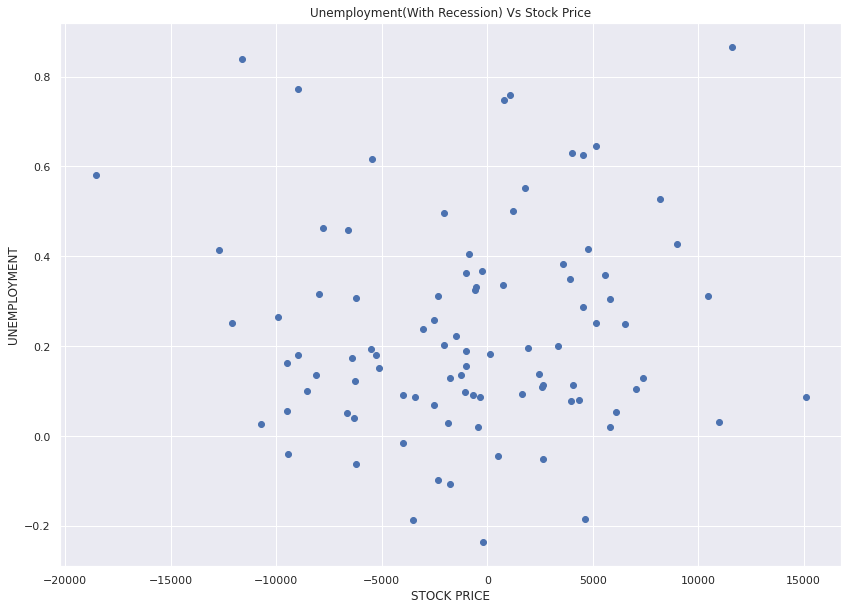

In [486]:
plt.scatter('SP500','UNEMPLOY',data=US_Recessions);
plt.ylabel('UNEMPLOYMENT');
plt.xlabel('STOCK PRICE');
plt.title("Unemployment(With Recession) Vs Stock Price")

Text(0.5, 1.0, 'Yearly scatter analysis for Unemployment without Recession')

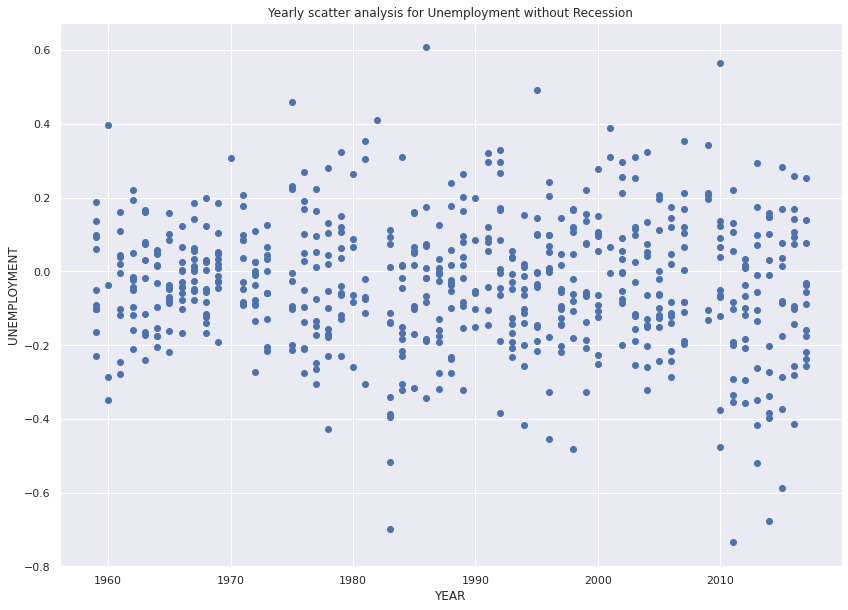

In [487]:
plt.scatter('YEAR','UNEMPLOY',data=US_NO_Recessions);
plt.ylabel('UNEMPLOYMENT');
plt.xlabel('YEAR');
plt.title("Yearly scatter analysis for Unemployment without Recession")

Text(0.5, 1.0, 'Unemployment(Without Recession) Vs Stock Price')

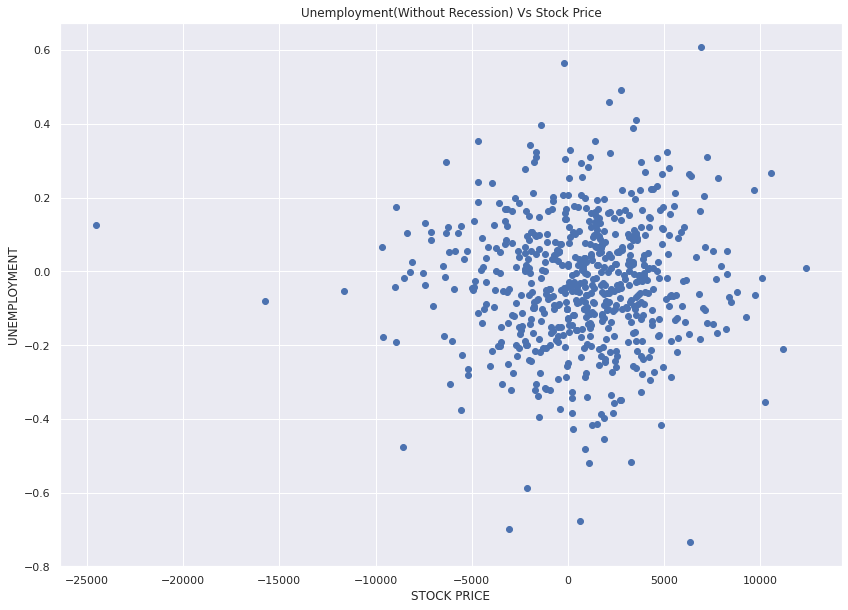

In [488]:
plt.scatter('SP500','UNEMPLOY',data=US_NO_Recessions);
plt.ylabel('UNEMPLOYMENT');
plt.xlabel('STOCK PRICE');
plt.title("Unemployment(Without Recession) Vs Stock Price")

Text(0.5, 1.0, 'Trend of Unemployment(With Recession) Vs Stock Price')

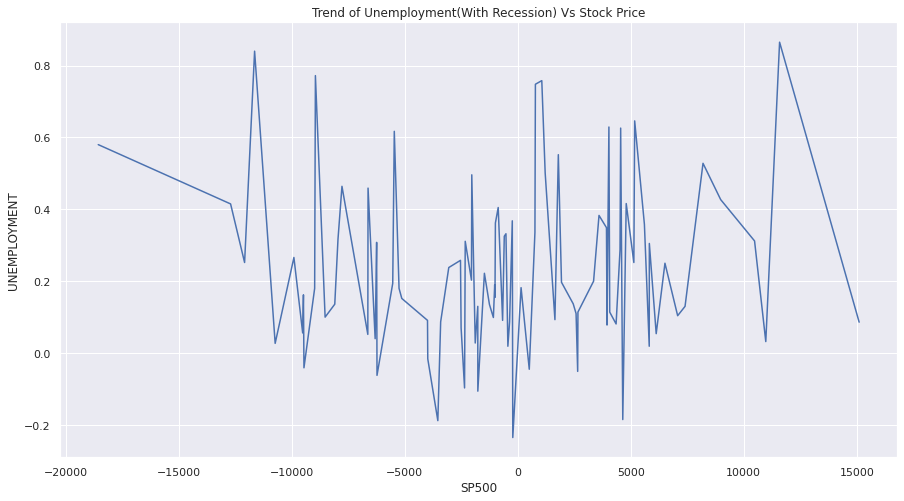

In [489]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='SP500',y='UNEMPLOY',data=US_Recessions)
plt.ylabel('UNEMPLOYMENT');
plt.title("Trend of Unemployment(With Recession) Vs Stock Price")

Text(0.5, 1.0, 'Trend of Unemployment(Without Recession) Vs Stock Price')

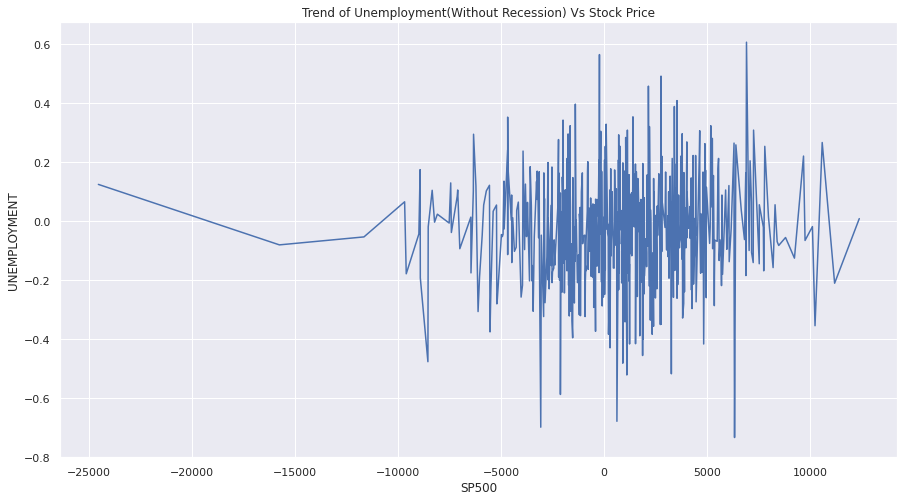

In [490]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='SP500',y='UNEMPLOY',data=US_NO_Recessions)
plt.ylabel('UNEMPLOYMENT');
plt.title("Trend of Unemployment(Without Recession) Vs Stock Price")

Text(0.5, 1.0, 'Yearly trend of Unemployment(With Recession)')

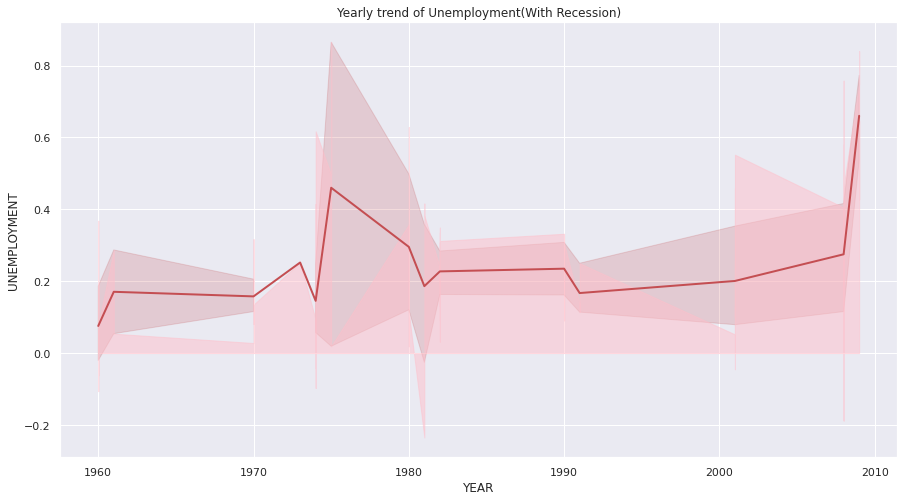

In [491]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='UNEMPLOY',data=US_Recessions, color='r',linewidth=2)
plt.fill_between(x='YEAR',y1='UNEMPLOY',data=US_Recessions, color='pink',alpha=0.5);
plt.ylabel('UNEMPLOYMENT');
plt.title("Yearly trend of Unemployment(With Recession)")

Text(0.5, 1.0, 'Yearly trend of Unemployment(Without Recession)')

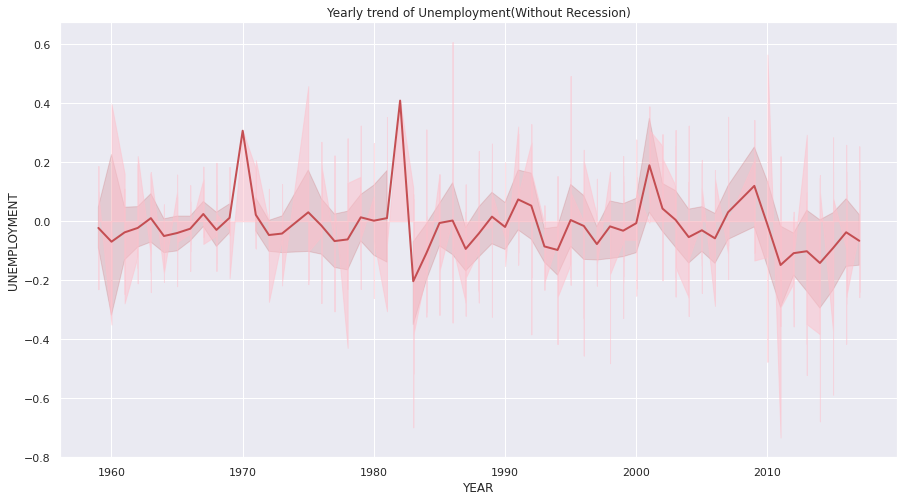

In [492]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='UNEMPLOY',data=US_NO_Recessions, color='r',linewidth=2)
plt.fill_between(x='YEAR',y1='UNEMPLOY',data=US_NO_Recessions, color='pink',alpha=0.5);
plt.ylabel('UNEMPLOYMENT');
plt.title("Yearly trend of Unemployment(Without Recession)")

Text(0.5, 1.0, 'Yearly trend of Stock Price(With Recession)')

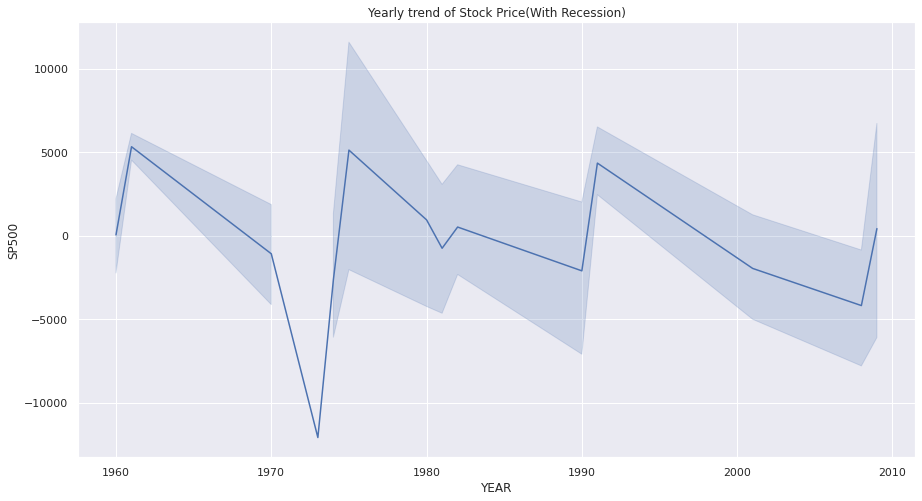

In [493]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='SP500',data=US_Recessions)
plt.ylabel('SP500');
plt.title("Yearly trend of Stock Price(With Recession)")

Text(0.5, 1.0, 'Yearly trend of Stock Price(Without Recession)')

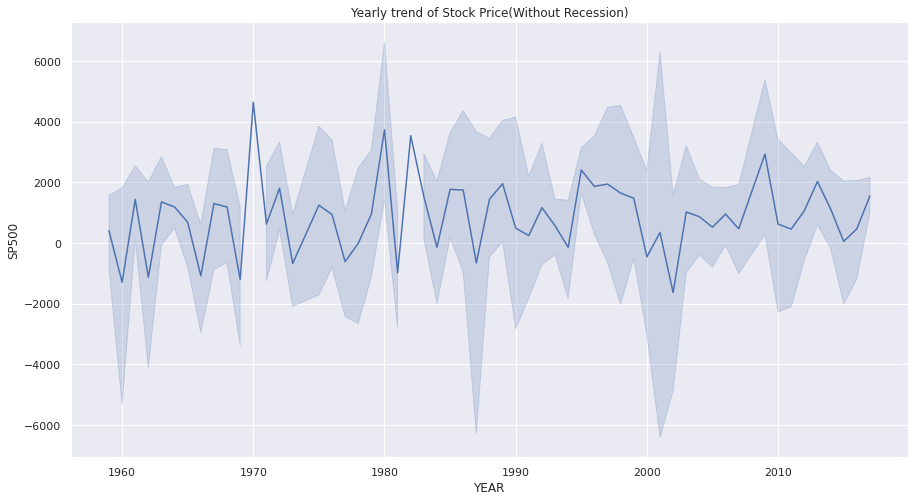

In [494]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='SP500',data=US_NO_Recessions)
plt.ylabel('SP500');
plt.title("Yearly trend of Stock Price(Without Recession)")

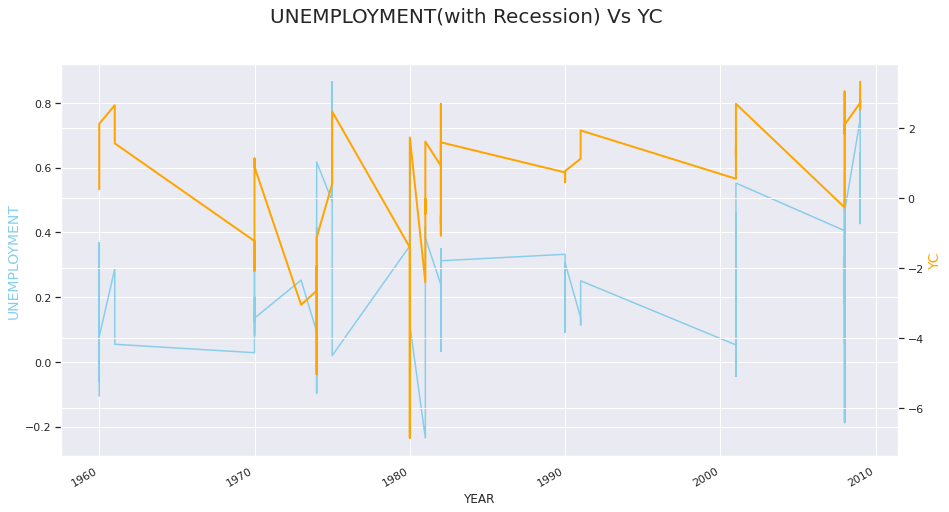

In [495]:
fig, ax1 = plt.subplots(figsize=(15, 8))
ax2 = ax1.twinx()

ax1.plot('YEAR','UNEMPLOY',data=US_Recessions, color='skyblue', lw=1.5)
ax2.plot('YEAR', 'YC',data=US_Recessions, color='orange', lw=2)

ax1.set_xlabel("YEAR")
ax1.set_ylabel("UNEMPLOYMENT",color='skyblue', fontsize=14)
ax1.tick_params(axis="y")

ax2.set_ylabel("YC", color='orange', fontsize=14)
ax2.tick_params(axis="y")

fig.suptitle("UNEMPLOYMENT(with Recession) Vs YC", fontsize=20)
fig.autofmt_xdate()

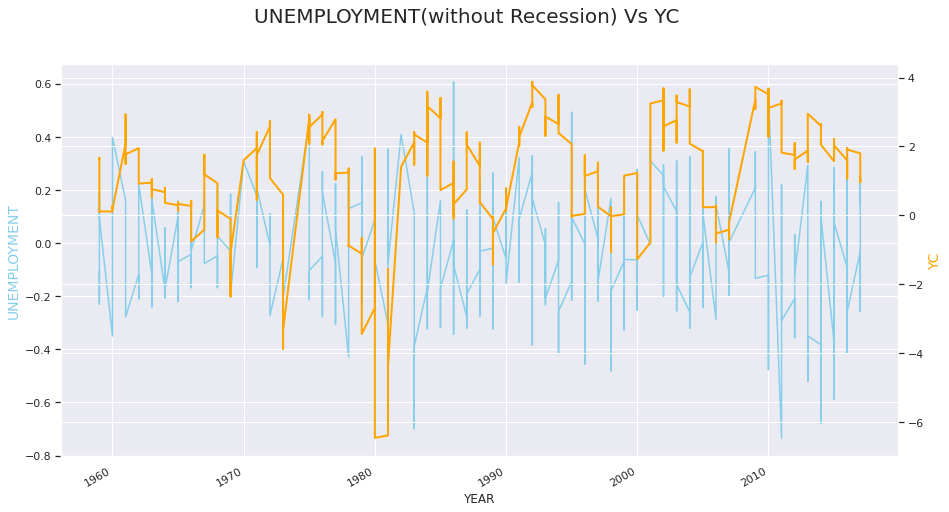

In [496]:
fig, ax1 = plt.subplots(figsize=(15, 8))
ax2 = ax1.twinx()

ax1.plot('YEAR','UNEMPLOY',data=US_NO_Recessions, color='skyblue', lw=1.5)
ax2.plot('YEAR', 'YC',data=US_NO_Recessions, color='orange', lw=2)

ax1.set_xlabel("YEAR")
ax1.set_ylabel("UNEMPLOYMENT",color='skyblue', fontsize=14)
ax1.tick_params(axis="y")

ax2.set_ylabel("YC", color='orange', fontsize=14)
ax2.tick_params(axis="y")

fig.suptitle("UNEMPLOYMENT(without Recession) Vs YC", fontsize=20)
fig.autofmt_xdate()

Text(0.5, 1.0, 'Yearly trend of Funds(With Recession)')

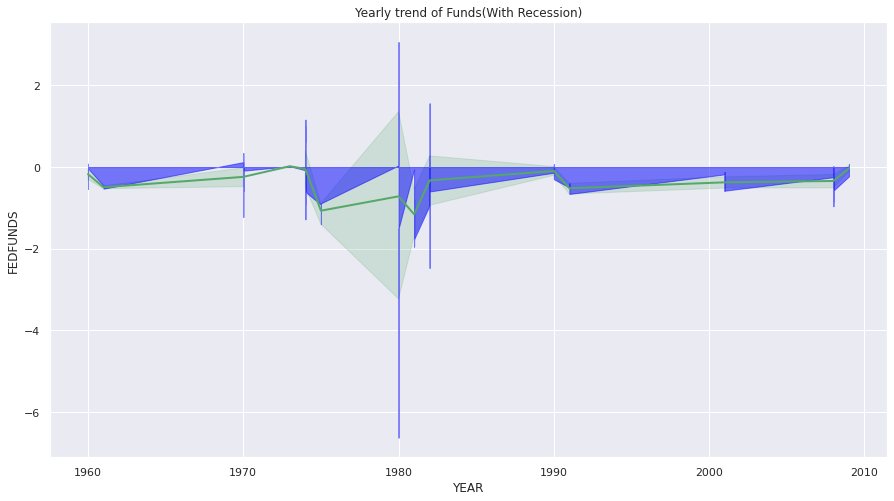

In [497]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='FEDFUNDS',data=US_Recessions, color='g',linewidth=2);
plt.fill_between(x='YEAR',y1='FEDFUNDS',data=US_Recessions, color='blue',alpha=0.5);
plt.title("Yearly trend of Funds(With Recession)")

Text(0.5, 1.0, 'Yearly trend of Funds(Without Recession)')

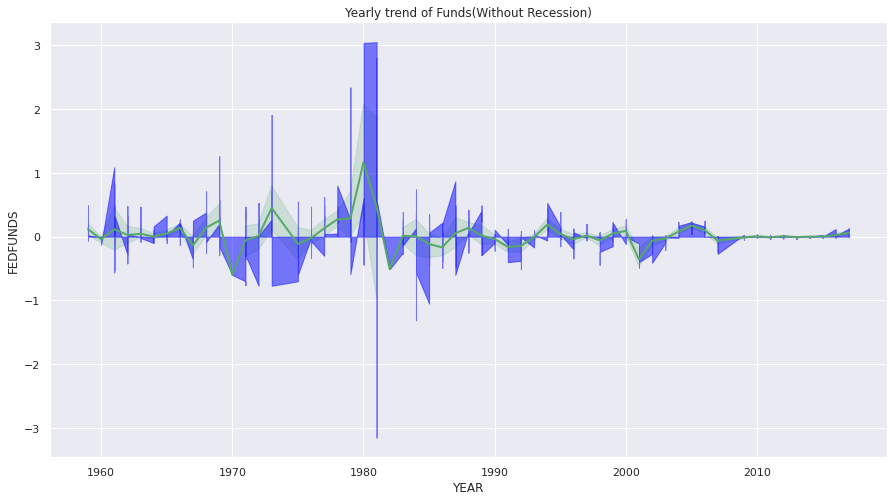

In [498]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='FEDFUNDS',data=US_NO_Recessions, color='g',linewidth=2);
plt.fill_between(x='YEAR',y1='FEDFUNDS',data=US_NO_Recessions, color='blue',alpha=0.5);
plt.title("Yearly trend of Funds(Without Recession)")

Text(0.5, 1.0, 'Stacked Area of Rate of Unemployment(With Recession)and Yield Curve')

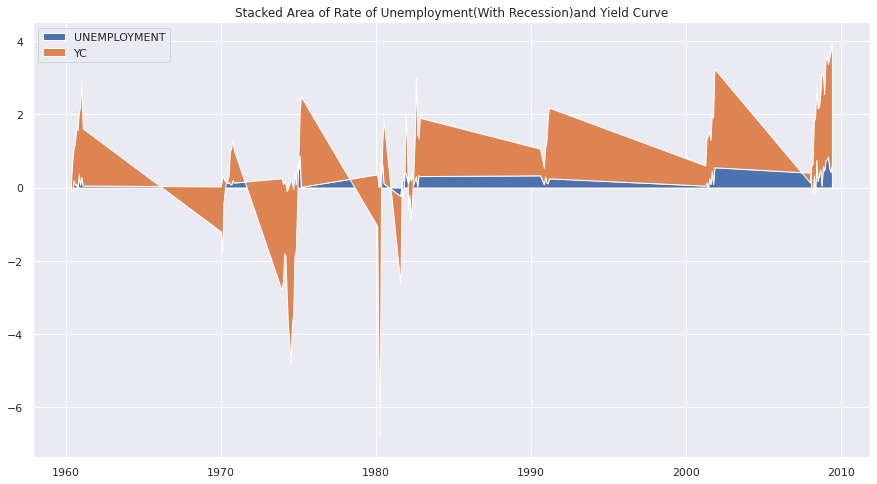

In [499]:
plt.subplots(figsize=(15, 8))
# Create data
x= np.array(US_Recessions.DATE)
y1= np.array(US_Recessions.UNEMPLOY)
y2= np.array(US_Recessions.YC)

# Basic stacked area chart.
plt.stackplot(x ,y1, y2 , data = US_Recessions, labels=['UNEMPLOYMENT','YC'])
plt.legend(loc='upper left');
plt.title("Stacked Area of Rate of Unemployment(With Recession)and Yield Curve")

Text(0.5, 1.0, 'Stacked Area of Rate of Unemployment(Without Recession)and Yield Curve')

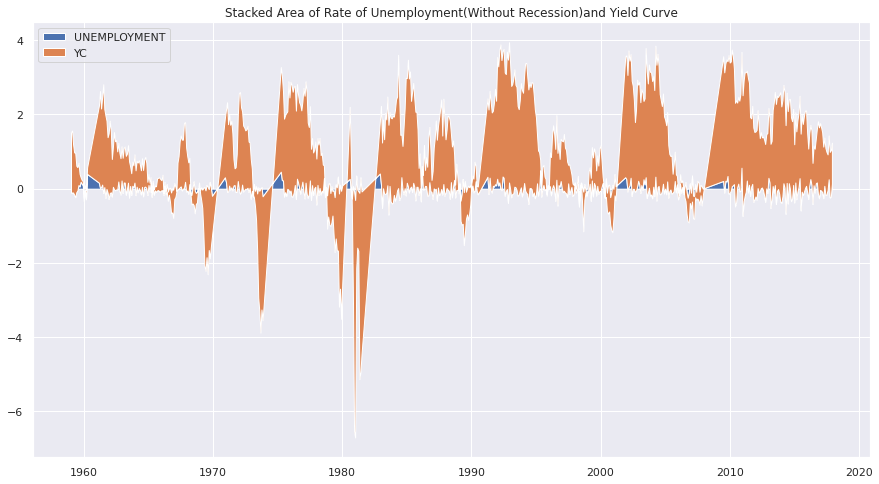

In [500]:
plt.subplots(figsize=(15, 8))
# Create data
x= np.array(US_NO_Recessions.DATE)
y1= np.array(US_NO_Recessions.UNEMPLOY)
y2= np.array(US_NO_Recessions.YC)

# Basic stacked area chart.
plt.stackplot(x ,y1, y2 , data = US_NO_Recessions, labels=['UNEMPLOYMENT','YC'])
plt.legend(loc='upper left');
plt.title("Stacked Area of Rate of Unemployment(Without Recession)and Yield Curve")

In [501]:
USRess_wide = pd.melt(US_Recessions,id_vars='YEAR',value_vars=['UNEMPLOY','FEDFUNDS','YC'],var_name='TYPE')
USRess_wide

,YEAR,TYPE,value
0,1960,UNEMPLOY,-0.106
1,1960,UNEMPLOY,-0.051
2,1960,UNEMPLOY,0.197
3,1960,UNEMPLOY,0.070
4,1960,UNEMPLOY,0.110
...,...,...,...
274,2009,YC,2.800
275,2009,YC,2.530
276,2009,YC,3.010
277,2009,YC,3.290


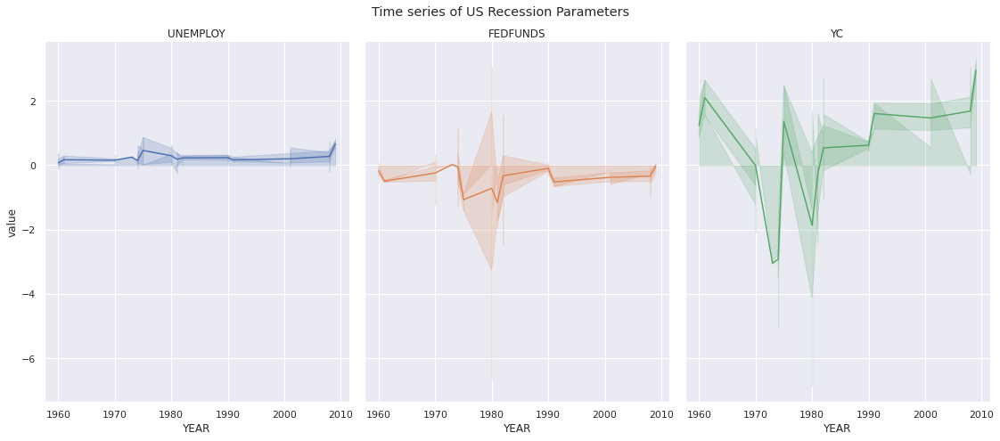

In [502]:
g = sns.FacetGrid(USRess_wide, col='TYPE', hue='TYPE', col_wrap=3, height=7, aspect=0.75);
g = g.map(sns.lineplot, 'YEAR', 'value'); 
g = g.map(plt.fill_between, 'YEAR', 'value', alpha=0.2)
g = g.set_titles("{col_name}")
plt.subplots_adjust(top=0.9)
g = g.fig.suptitle('Time series of US Recession Parameters')
plt.show();

In [503]:
US_NO_Ress_wide = pd.melt(US_NO_Recessions,id_vars='YEAR',value_vars=['UNEMPLOY','FEDFUNDS','YC'],var_name='TYPE')
US_NO_Ress_wide

,YEAR,TYPE,value
0,1959,UNEMPLOY,-0.103
1,1959,UNEMPLOY,-0.103
2,1959,UNEMPLOY,-0.103
3,1959,UNEMPLOY,-0.164
4,1959,UNEMPLOY,-0.230
...,...,...,...
1840,2017,YC,0.960
1841,2017,YC,1.180
1842,2017,YC,1.230
1843,2017,YC,1.260


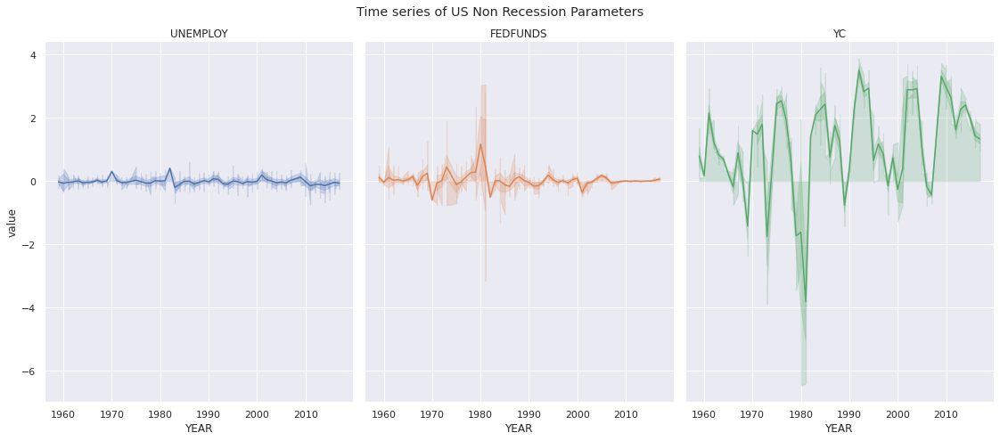

In [504]:
g = sns.FacetGrid(US_NO_Ress_wide, col='TYPE', hue='TYPE', col_wrap=3, height=7, aspect=0.75);
g = g.map(sns.lineplot, 'YEAR', 'value'); 
g = g.map(plt.fill_between, 'YEAR', 'value', alpha=0.2)
g = g.set_titles("{col_name}")
plt.subplots_adjust(top=0.9)
g = g.fig.suptitle('Time series of US Non Recession Parameters')
plt.show();

In [ ]:
US_Recessions['UNEMPLOY_diff'] = US_Recessions['UNEMPLOY'] - US_Recessions['UNEMPLOY'].pct_change(periods=1) 
US_NO_Recessions['UNEMPLOY_diff'] = US_NO_Recessions['UNEMPLOY'] - US_NO_Recessions['UNEMPLOY'].pct_change(periods=1) 

Text(0.5, 1.0, 'Visualizing Employment % Change between US Recession and US Non Recession')

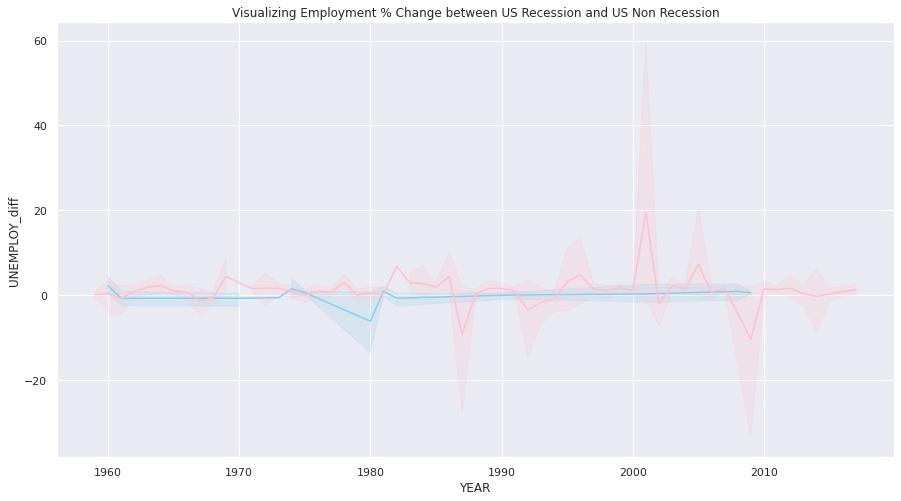

In [506]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='UNEMPLOY_diff',data=US_Recessions,color='skyblue');
sns.lineplot(x='YEAR',y='UNEMPLOY_diff',data=US_NO_Recessions,color='pink');
plt.title("Visualizing Employment % Change between US Recession and US Non Recession")

In [ ]:
US_Recessions['INDPRO_diff'] = US_Recessions['INDPRO'] - US_Recessions['INDPRO'].shift(periods=1) 
US_NO_Recessions['INDPRO_diff'] = US_NO_Recessions['INDPRO'] - US_NO_Recessions['INDPRO'].shift(periods=1) 

Text(0.5, 1.0, 'Visualizing Industrial Production shifts between US Recession and US Non Recession')

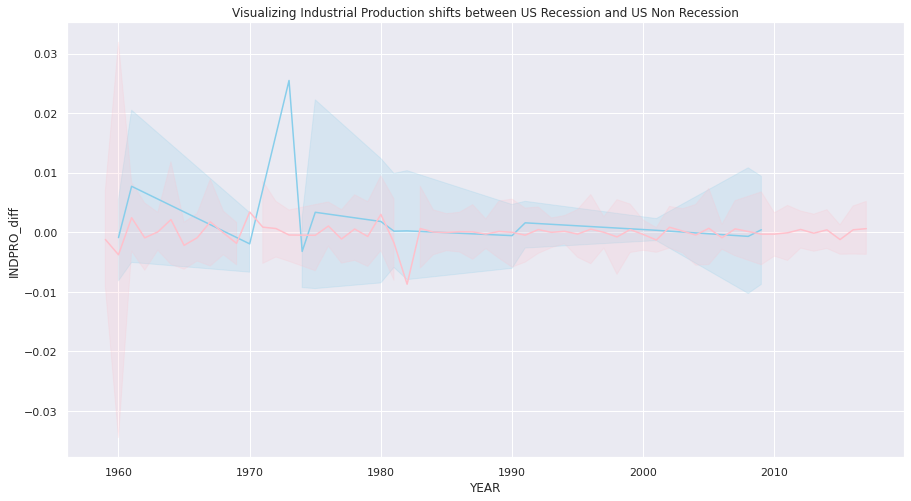

In [508]:
plt.figure(figsize=(15,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='INDPRO_diff',data=US_Recessions,color='skyblue');
sns.lineplot(x='YEAR',y='INDPRO_diff',data=US_NO_Recessions,color='pink');
plt.title("Visualizing Industrial Production shifts between US Recession and US Non Recession")

In [509]:
USRess['CPI_Avg_10'] = USRess['CPI'].rolling(window=10).mean()
USRess['CPI_Avg_20'] = USRess['CPI'].rolling(window=20).mean()
USRess.head(30)

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC,YEAR,CPI_Avg_10,CPI_Avg_20
0,1/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.62,1959,NaN,NaN
1,2/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.67,1959,NaN,NaN
2,3/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.30,1959,NaN,NaN
3,4/1/1959,n,0.00000,0.37,0.014302,0.006168,54.1254,-0.164,1.14,1959,NaN,NaN
4,5/1/1959,n,-3.44768,0.16,0.021079,0.005774,3804.7605,-0.230,1.20,1959,NaN,NaN
5,6/1/1959,n,-10.35018,-0.06,0.014951,0.004286,1875.0012,-0.092,0.71,1959,NaN,NaN
6,7/1/1959,n,3.45125,0.49,0.001141,0.002443,-358.5134,-0.050,0.63,1959,NaN,NaN
7,8/1/1959,n,20.68253,0.08,-0.024239,0.002289,3429.4788,0.099,0.60,1959,NaN,NaN
8,9/1/1959,n,24.07568,0.03,-0.034466,-0.008736,-1515.3067,0.060,0.34,1959,NaN,NaN
9,10/1/1959,n,13.73155,0.26,-0.001206,0.001723,-4671.1737,0.187,0.12,1959,4.814315,NaN


Text(0.5, 1.0, 'Average Overview of Consumer Price Index in specified number of periods(Year)')

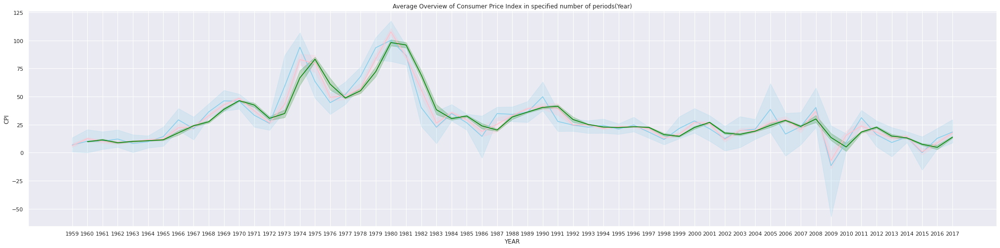

In [510]:
plt.figure(figsize=(35,8))
sns.set_theme(style='darkgrid')
sns.lineplot(x='YEAR',y='CPI',data=USRess,color='skyblue');
sns.lineplot(x='YEAR',y='CPI_Avg_10',data=USRess,color='pink');
sns.lineplot(x='YEAR',y='CPI_Avg_20',data=USRess,color='green');
plt.title("Average Overview of Consumer Price Index in specified number of periods(Year)")

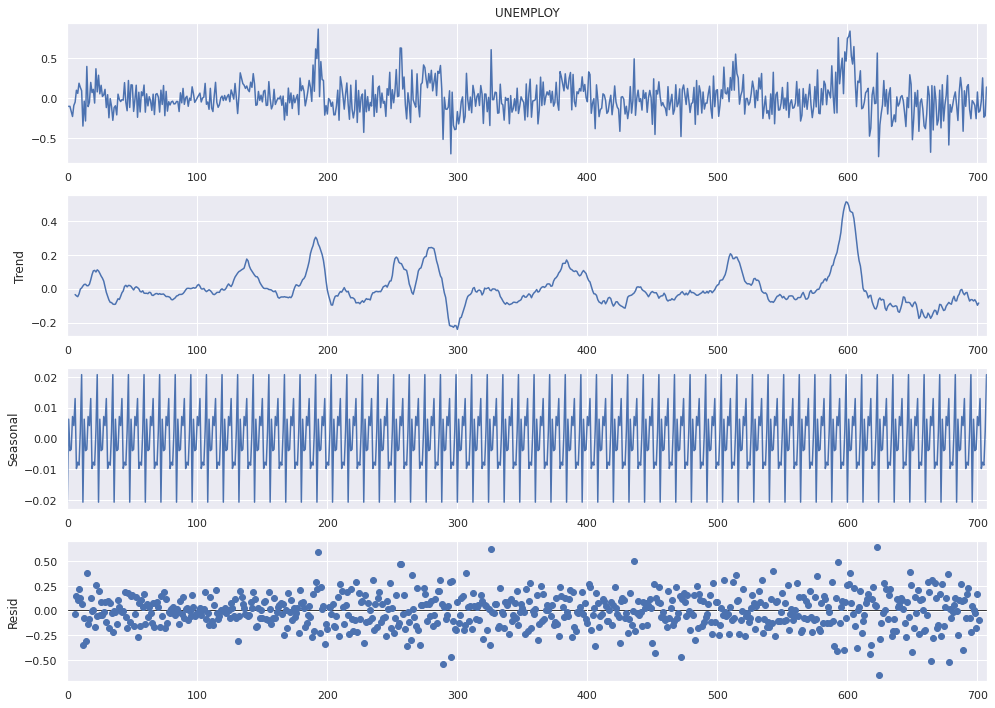

In [511]:
from statsmodels.tsa.seasonal import seasonal_decompose

decompose = seasonal_decompose(USRess['UNEMPLOY'], model='additive', period=12)

plt.rcParams['figure.figsize'] = (14, 10)
decompose.plot()
plt.show()

In [512]:
USRess['Month'] = pd.DatetimeIndex(USRess.DATE).month
USRess

,DATE,RECESSION,CPI,FEDFUNDS,INDPRO,PAYEMS,SP500,UNEMPLOY,YC,YEAR,CPI_Avg_10,CPI_Avg_20,Month
0,1/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.62,1959,NaN,NaN,1
1,2/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.67,1959,NaN,NaN,2
2,3/1/1959,n,0.00000,-0.05,0.019395,0.003994,-72.1649,-0.103,1.30,1959,NaN,NaN,3
3,4/1/1959,n,0.00000,0.37,0.014302,0.006168,54.1254,-0.164,1.14,1959,NaN,NaN,4
4,5/1/1959,n,-3.44768,0.16,0.021079,0.005774,3804.7605,-0.230,1.20,1959,NaN,NaN,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...
703,8/1/2017,n,-8.39574,0.11,-0.000404,0.001555,1916.4018,-0.036,0.96,2017,16.391303,13.645884,8
704,9/1/2017,n,6.10297,0.01,-0.004748,0.001294,54.6284,0.254,1.18,2017,15.154086,13.456537,9
705,10/1/2017,n,2.53839,-0.01,0.000026,0.000286,1911.9039,-0.239,1.23,2017,12.788150,12.986504,10
706,11/1/2017,n,37.79487,0.00,0.015057,0.001693,2194.5560,-0.220,1.26,2017,14.227689,15.414313,11


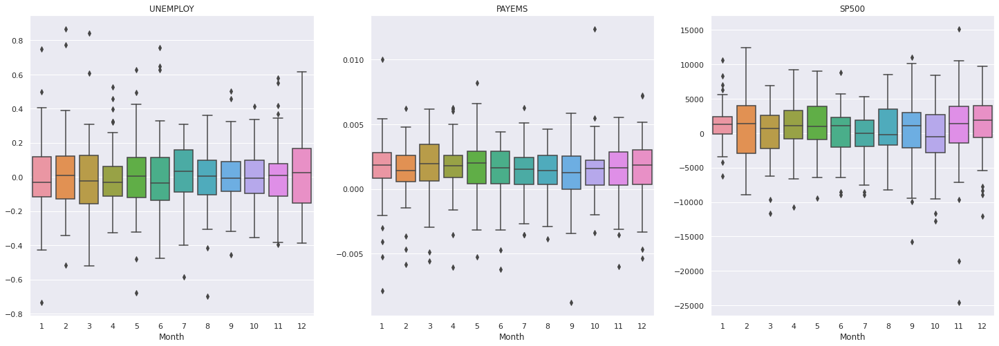

In [513]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8), sharex=True)
for name, ax in zip(['UNEMPLOY', 'PAYEMS', 'SP500'], axes):
    sns.boxplot(data = USRess, x='Month', y=name, ax=ax)
    ax.set_ylabel("")
    ax.set_title(name)

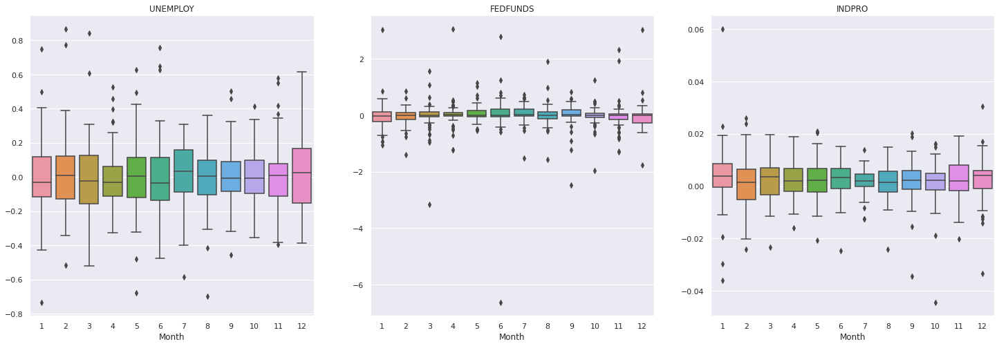

In [514]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8), sharex=True)
for name, ax in zip(['UNEMPLOY', 'FEDFUNDS', 'INDPRO'], axes):
    sns.boxplot(data = USRess, x='Month', y=name, ax=ax)
    ax.set_ylabel("")
    ax.set_title(name)

Text(0.5, 1.0, 'Rate of Unemployment against Total Payroll')

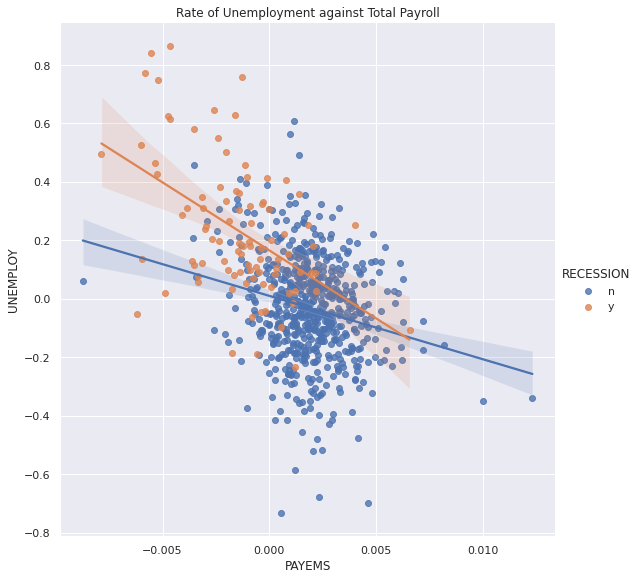

In [515]:
sns.set_theme(style='darkgrid')
sns.lmplot(data=USRess,x='PAYEMS',y='UNEMPLOY',hue='RECESSION',height=8);
plt.title("Rate of Unemployment against Total Payroll")

Text(0.5, 1.0, 'Year wise Rate of Unemployment')

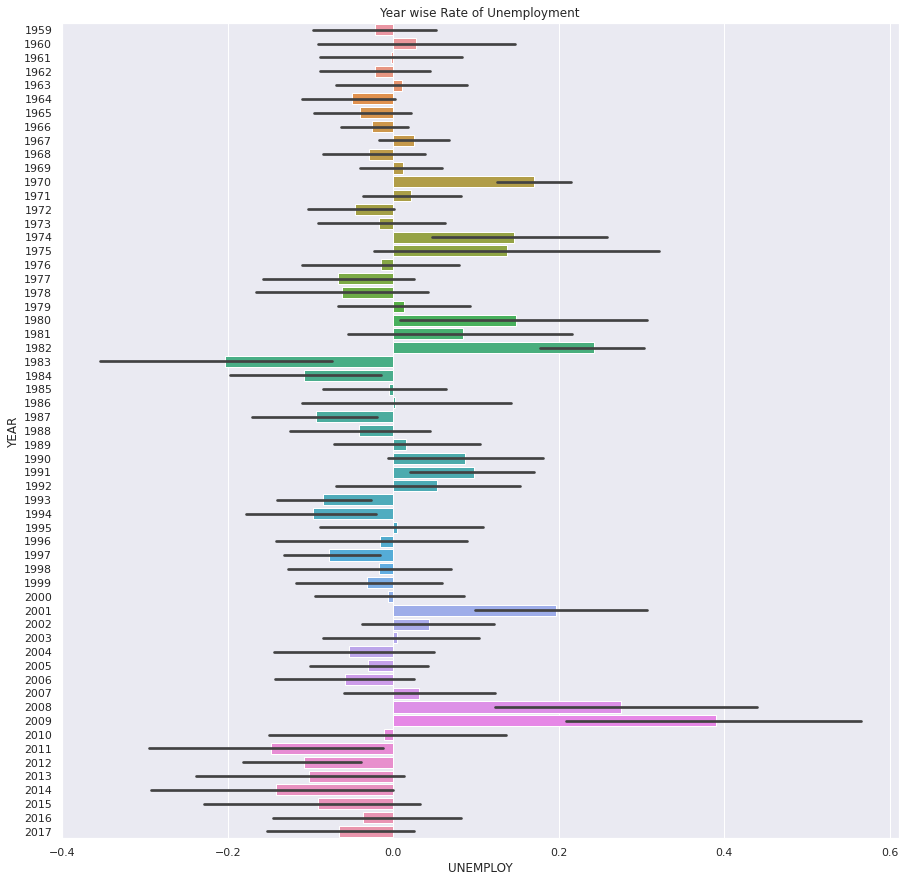

In [516]:
plt.figure(figsize=(15,15))
sns.barplot(x=USRess.UNEMPLOY,y=USRess.YEAR);
plt.title("Year wise Rate of Unemployment")

In [517]:
pd.crosstab(index=USRess.PAYEMS, columns=USRess.YC).style.background_gradient(cmap=plt.cm.Greens).highlight_max(color='orange')